In [1]:
%pip install spotipy
%pip install python-dotenv
%conda create -n spotify-analysis python=3.11 "numpy<2" pandas matplotlib seaborn
%conda activate spotify-analysis
%pip install spotipy datapane chart-studio

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.

Note: you may need to restart the kernel to use updated packages.


The system cannot find the file specified.



Note: you may need to restart the kernel to use updated packages.



CondaError: Run 'conda init' before 'conda activate'



Note: you may need to restart the kernel to use updated packages.


In [24]:

%pip install streamlit

import numpy as np
import streamlit as st
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import spotipy
import chart_studio.plotly as py
import chart_studio
%matplotlib inline
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
import os
client_id = os.environ.get("SPOTIPY_CLIENT_ID")
client_secret = os.environ.get("SPOTIPY_CLIENT_SECRET")

sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(
    client_id=client_id,
    client_secret=client_secret
))


Note: you may need to restart the kernel to use updated packages.


In [3]:
# reading the data 
data = pd.read_csv('C:\\Users\\Nullvoid\\Desktop\\Music recommendation system\\Spotify\\data.csv')
artist_data = pd.read_csv('C:\\Users\\Nullvoid\\Desktop\\Music recommendation system\\Spotify\\data_by_artist.csv')
genre_data = pd.read_csv('C:\\Users\\Nullvoid\\Desktop\\Music recommendation system\\Spotify\\data_by_genres.csv')
year_data = pd.read_csv('C:\\Users\\Nullvoid\\Desktop\\Music recommendation system\\Spotify\\data_by_year.csv')
data.head(10)

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665
5,0.1960,1921,0.579,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.697,395076,0.346,0,4pyw9DVHGStUre4J6hPngr,0.168000,2,0.130,-12.506,1,Gati Mardika,6,1921,0.0700,119.824
6,0.4060,1921,0.996,['John McCormack'],0.518,159507,0.203,0,5uNZnElqOS3W4fRmRYPk4T,0.000000,0,0.115,-10.589,1,The Wearing of the Green,4,1921,0.0615,66.221
7,0.0731,1921,0.993,['Sergei Rachmaninoff'],0.389,218773,0.088,0,02GDntOXexBFUvSgaXLPkd,0.527000,1,0.363,-21.091,0,"Morceaux de fantaisie, Op. 3: No. 2, Prélude i...",2,1921,0.0456,92.867
8,0.7210,1921,0.996,['Ignacio Corsini'],0.485,161520,0.130,0,05xDjWH9ub67nJJk82yfGf,0.151000,5,0.104,-21.508,0,La Mañanita - Remasterizado,0,1921-03-20,0.0483,64.678
9,0.7710,1921,0.982,['Fortugé'],0.684,196560,0.257,0,08zfJvRLp7pjAb94MA9JmF,0.000000,8,0.504,-16.415,1,Il Etait Syndiqué,0,1921,0.3990,109.378


In [4]:
# get data info
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [5]:
# get year data info 
year_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


In [6]:
def get_decade(year):
    
    period_start = int(year/10) * 10
    decade = '{}s'.format(period_start)
    
    return decade

data['decade'] = data['year'].apply(get_decade)
display(data)

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,decade
0,0.0594,1921,0.98200,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.6650,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954,1920s
1,0.9630,1921,0.73200,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.1600,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936,1920s
2,0.0394,1921,0.96100,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.1010,-14.850,1,Gati Bali,5,1921,0.0339,110.339,1920s
3,0.1650,1921,0.96700,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.3810,-9.316,1,Danny Boy,3,1921,0.0354,100.109,1920s
4,0.2530,1921,0.95700,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.2290,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665,1920s
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170648,0.6080,2020,0.08460,"['Anuel AA', 'Daddy Yankee', 'KAROL G', 'Ozuna...",0.786,301714,0.808,0,0KkIkfsLEJbrcIhYsCL7L5,0.000289,7,0.0822,-3.702,1,China,72,2020-05-29,0.0881,105.029,2020s
170649,0.7340,2020,0.20600,['Ashnikko'],0.717,150654,0.753,0,0OStKKAuXlxA0fMH54Qs6E,0.000000,7,0.1010,-6.020,1,Halloweenie III: Seven Days,68,2020-10-23,0.0605,137.936,2020s
170650,0.6370,2020,0.10100,['MAMAMOO'],0.634,211280,0.858,0,4BZXVFYCb76Q0Klojq4piV,0.000009,4,0.2580,-2.226,0,AYA,76,2020-11-03,0.0809,91.688,2020s
170651,0.1950,2020,0.00998,['Eminem'],0.671,337147,0.623,1,5SiZJoLXp3WOl3J4C8IK0d,0.000008,2,0.6430,-7.161,1,Darkness,70,2020-01-17,0.3080,75.055,2020s


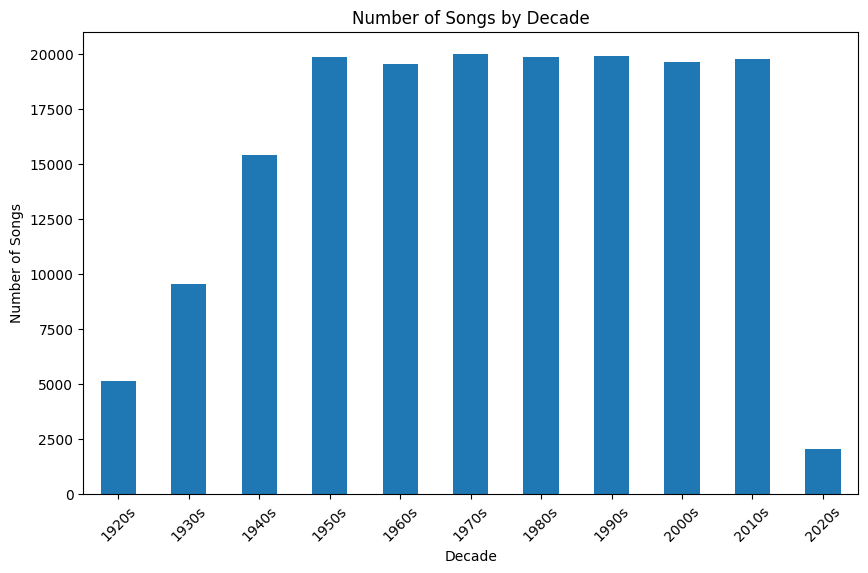

In [7]:
# to show the decade column visualization
data['decade'].value_counts().sort_index().plot(kind='bar', figsize=(10, 6))
plt.title('Number of Songs by Decade')
plt.xlabel('Decade')
plt.ylabel('Number of Songs')
plt.xticks(rotation=45)
plt.show()


In [8]:
# Plot the trends of various sound features (acousticness, danceability, energy, instrumentalness, liveness, valence) over decades using a line plot: px.line(year_data, x='year', y=sound_features, title='Trend of various sound features over decades').
import plotly.express as px
sound_features = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'valence']
fig = px.line(year_data, x='year', y=sound_features, title='Trend of various sound features over decades')
fig.show()

In [9]:
# Plot the trend of loudness over decades using a line plot: px.line(year_data, x='year', y='loudness', title='Trend of loudness over decades').
fig = px.line(year_data, x='year', y='loudness', title='Trend of loudness over decades')
fig.show()

In [10]:
# Identify the top 10 genres based on popularity and plot the trends of various sound features (valence, energy, danceability, acousticness) for these genres using a grouped bar chart: px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group', title='Trend of various sound features over top 10 genres').
top10_genres = genre_data.sort_values('popularity', ascending=False).head(10)
fig = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group', title='Trend of various sound features over top 10 genres')
fig.show()


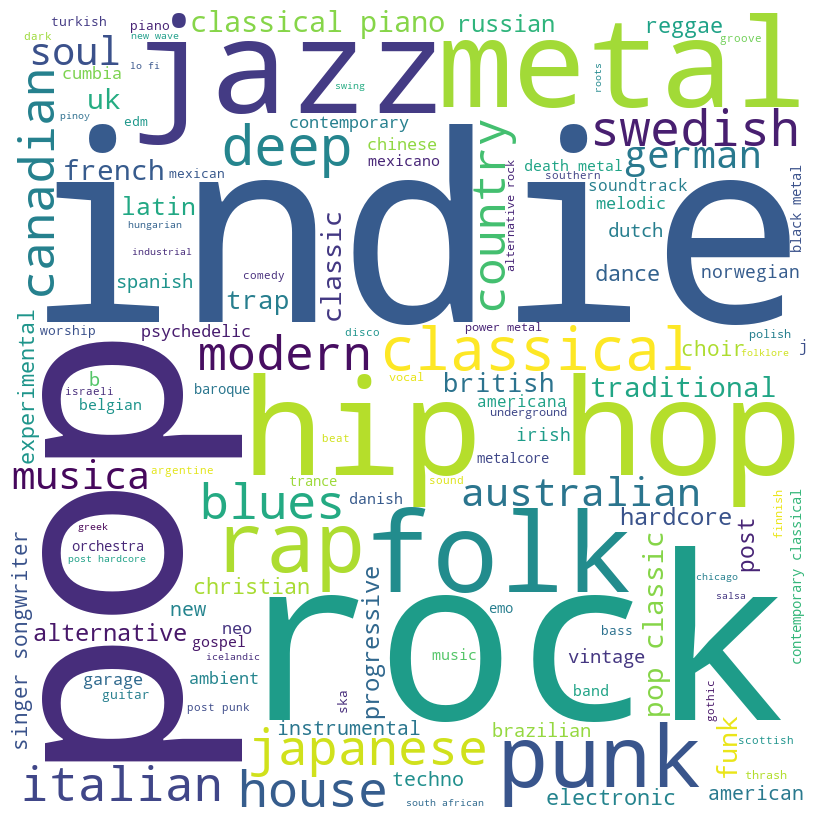

In [11]:
# Generate a word cloud of the genres present in the dataset using the WordCloud library: WordCloud(width=800, height=800, background_color='white', stopwords=stopwords, max_words=40, min_font_size=10).generate(comment_words)
from wordcloud import WordCloud, STOPWORDS
comment_words = ''
# Assuming the column with genres is named 'genre'
comment_words = " ".join(str(genre) for genre in genre_data['genres'].dropna())
# Define stopwords
stopwords = set(STOPWORDS)
# Generate the WordCloud
wordcloud = WordCloud(width=800, height=800,
                      background_color='white',
                      stopwords=stopwords,
                      max_words=150,
                      min_font_size=10).generate(comment_words)
# Display the WordCloud
plt.figure(figsize=(8, 8), facecolor=None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad=0)
plt.show()

(-0.5, 799.5, 799.5, -0.5)

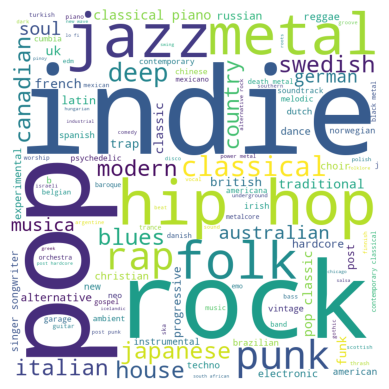

In [12]:
# Plot the word cloud of the genres: plt.imshow(wordcloud).
plt.imshow(wordcloud)
plt.axis("off")


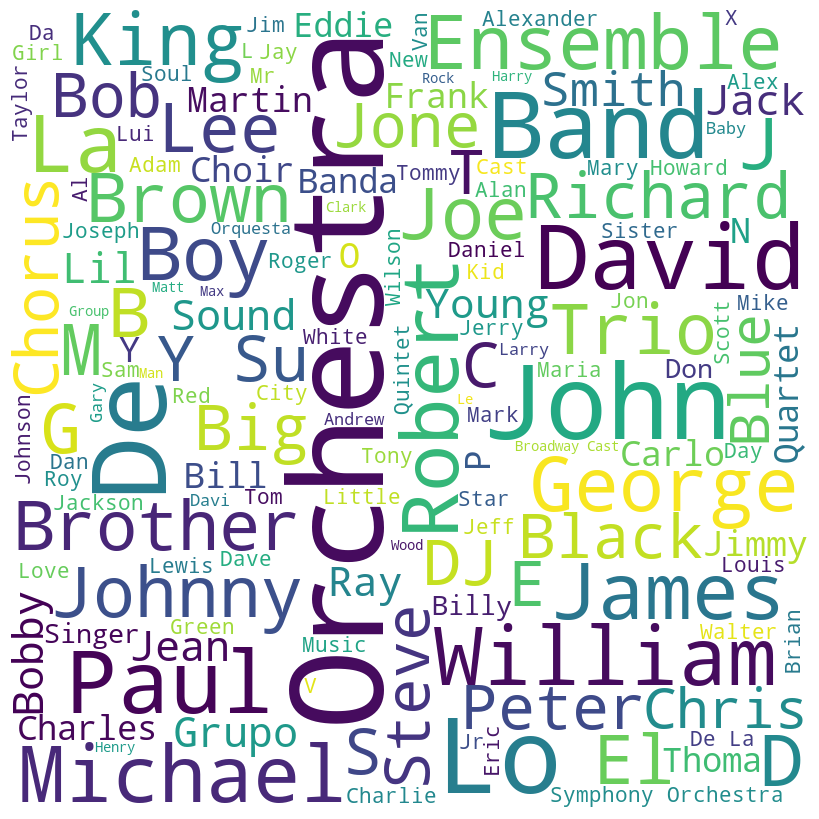

In [13]:
# Generate a word cloud of the genres present in the dataset using the WordCloud library: WordCloud(width=800, height=800, background_color='white', stopwords=stopwords, max_words=40, min_font_size=10).generate(comment_words)
from wordcloud import WordCloud, STOPWORDS
comment_words = ''
# Assuming the column with genres is named 'genre'
comment_words = " ".join(str(artist) for artist in artist_data['artists'].dropna())
# Define stopwords
stopwords = set(STOPWORDS)
# Generate the WordCloud
wordcloud = WordCloud(width=800, height=800,
                      background_color='white',
                      stopwords=stopwords,
                      max_words=150,
                      min_font_size=10).generate(comment_words)
# Display the WordCloud
plt.figure(figsize=(8, 8), facecolor=None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad=0)
plt.show()

(-0.5, 799.5, 799.5, -0.5)

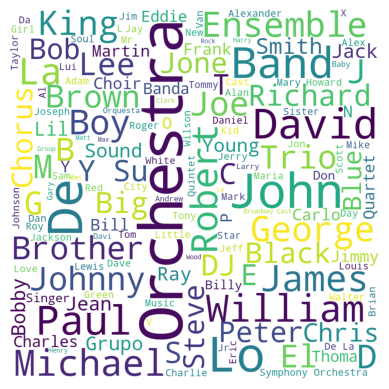

In [14]:
# Plot the word cloud of the artists: plt.imshow(wordcloud).
plt.imshow(wordcloud)
plt.axis("off")

In [15]:

import pandas as pd
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

# Step 1: Group data by genre and compute mean of numeric features
numeric_cols = genre_data.select_dtypes(include=['float64', 'int64']).columns.tolist()
# Remove the 'cluster' column if it was added in a previous step
if 'cluster' in numeric_cols:
    numeric_cols.remove('cluster')

# No grouping needed as genre_data is already aggregated by genre
# Use the existing genre_data DataFrame

# Step 2: Standardize the numeric features
scaler = StandardScaler()
scaled_genre_data = scaler.fit_transform(genre_data[numeric_cols])

# Step 3: Fit KMeans model with 12 clusters
kmeans = KMeans(n_clusters=12, n_init=10, random_state=42)
kmeans.fit(scaled_genre_data)

# Step 4: Assign cluster labels to each genre
genre_data['cluster'] = kmeans.labels_

# Step 5: Preview the result
display(genre_data[['genres', 'cluster']].head())

# print the model information
print("KMeans Model:")
print(f"Number of clusters: {kmeans.n_clusters}")
print(f"Inertia (sum of squared distances to centroids): {kmeans.inertia_}")
print(f"Number of iterations run: {kmeans.n_iter_}")

centroids = pd.DataFrame(kmeans.cluster_centers_, columns=numeric_cols)
print("\nCluster Centers:")
print(centroids)

,genres,cluster
0,21st century classical,2
1,432hz,6
2,8-bit,9
3,[],7
4,a cappella,1


KMeans Model:
Number of clusters: 12
Inertia (sum of squared distances to centroids): 17960.02949462798
Number of iterations run: 57

Cluster Centers:
        mode  acousticness  danceability  duration_ms    energy  \
0   0.139691     -0.758998      0.081704     0.778094  0.467158   
1   0.447484      0.474549     -0.080271    -0.125199 -0.558878   
2   0.199897      1.492322     -1.451508     0.344327 -1.698167   
3  -2.234715     -0.711080      0.650254    -0.015359  0.649607   
4   0.447484     -0.628107      0.663166    -0.135124  0.538722   
5  -0.186490      0.101739     -0.275147     0.578790  0.211361   
6  -0.446582      1.227863     -1.289486    13.812026 -1.075897   
7   0.447484      1.229838     -0.072540    -0.403367 -0.893954   
8   0.245759     -1.011891     -0.808635    -0.032152  1.152400   
9   0.447484     -0.413489      0.668960    -0.180530  0.414642   
10 -2.234715      0.795736     -0.139720    -0.253384 -0.672560   
11 -0.284025      0.937105      0.476095     

In [16]:
# Visualize the clusters of genres using t-SNE dimensionality reduction technique. Plot the scatter plot with clusters colored and display genre information on hover.

import plotly.express as px
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler

# Select numeric features (drop the non-numeric 'genres')
numeric_cols = genre_data.drop('genres', axis=1).select_dtypes(include=['float64', 'int64']).columns.tolist()

# Drop missing values and reset index
genre_clean = genre_data.dropna(subset=numeric_cols).reset_index(drop=True)

# Standardize numeric data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(genre_clean[numeric_cols])

# Run t-SNE (2D)
tsne = TSNE(n_components=2, random_state=42, perplexity=30)
tsne_result = tsne.fit_transform(scaled_data)

# Create DataFrame for plotting
tsne_df = pd.DataFrame(tsne_result, columns=['TSNE1', 'TSNE2'])
tsne_df['Cluster'] = genre_clean['cluster']
tsne_df['Genre'] = genre_clean['genres']

# Plot with Plotly
fig = px.scatter(
    tsne_df,
    x='TSNE1',
    y='TSNE2',
    color='Cluster',
    hover_data=['Genre'],
    title="t-SNE Visualization of Genre Clusters"
)

fig.show()


In [17]:
# Visualize the clusters of songs using PCA dimensionality reduction technique.
# Plot the scatter plot with clusters colored and display song information on hover.

import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans

# Step 1: Select only numeric columns for PCA (excluding 'cluster' if it exists)
numeric_cols_for_pca = data.select_dtypes(include=['float64', 'int64']).columns.tolist()
if 'cluster' in numeric_cols_for_pca:
    numeric_cols_for_pca.remove('cluster')

# Step 2: Handle missing values
data_clean = data.dropna(subset=numeric_cols_for_pca)

# Step 3: Standardize numeric features
scaler = StandardScaler()
scaled_data = scaler.fit_transform(data_clean[numeric_cols_for_pca])

# Step 4: Run KMeans clustering (adjust number of clusters as needed, e.g. 5 or 10)
kmeans = KMeans(n_clusters=5, n_init=10, random_state=42)
data_clean['cluster'] = kmeans.fit_predict(scaled_data)

# Step 5: Apply PCA (reduce to 2 dimensions)
pca = PCA(n_components=2, random_state=42)
song_pca = pca.fit_transform(scaled_data)

# Step 6: Create DataFrame for visualization
pca_df = pd.DataFrame(song_pca, columns=['PC1', 'PC2'])
pca_df.index = data_clean.index
pca_df['Cluster'] = data_clean['cluster']
pca_df['Title'] = data_clean['name']
pca_df['Artist'] = data_clean['artists']

# Step 7: Plot PCA scatter with Plotly
fig = px.scatter(
    pca_df,
    x='PC1',
    y='PC2',
    color='Cluster',
    hover_data=['Title', 'Artist'],
    title='PCA Visualization of Song Clusters'
)

fig.show()


In [18]:
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(client_id=os.environ["SPOTIPY_CLIENT_ID"],
                                                           client_secret=os.environ["SPOTIPY_CLIENT_SECRET"]))


def find_song(name, year):
    
    song_data = defaultdict()
    results = sp.search(q= 'track: {} year: {}'.format(name,
                                                       year), limit=1)
    if results['tracks']['items'] == []:
        return None
    
    results = results['tracks']['items'][0]

    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]
    
    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]
    
    for key, value in audio_features.items():
        song_data[key] = value
    
    return pd.DataFrame(song_data)
    

In [19]:
from collections import defaultdict
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist
import difflib
import numpy as np

number_cols = ['valence', 'year', 'acousticness', 'danceability', 'duration_ms', 'energy', 'explicit',
 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'popularity', 'speechiness', 'tempo']

def get_song_data(song, data):
    """Get song data from the dataset"""
    try:
        # Filter the data
        filtered_data = data[(data['name'] == song['name']) & (data['year'] == song['year'])]
        
        # Check if any results were found
        if filtered_data.empty:
            print(f"Warning: '{song['name']}' ({song['year']}) not found in dataset")
            return None
            
        song_data = filtered_data.iloc[0]
        return song_data
    
    except Exception as e:
        print(f"Error finding song '{song['name']}' ({song['year']}): {e}")
        return None
        
def get_mean_vector(song_list, data):
    """Calculate mean vector of song features"""
    song_vectors = []
    
    for song in song_list:
        song_data = get_song_data(song, data)
        if song_data is None:
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)  
    
    if not song_vectors:
        raise ValueError("None of the requested songs were found in the dataset")
    
    song_matrix = np.array(list(song_vectors))
    return np.mean(song_matrix, axis=0)

def flatten_dict_list(dict_list):
    """Flatten a list of dictionaries"""
    flattened_dict = defaultdict(list)
    
    for dictionary in dict_list:
        for key, value in dictionary.items():
            flattened_dict[key].append(value)
            
    return flattened_dict
        
def recommend_songs(song_list, data, n_songs=10):
    """Recommend songs based on input song list"""
    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)
    
    song_center = get_mean_vector(song_list, data)
    scaled_data = scaler.transform(data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    distances = cdist(scaled_song_center, scaled_data, 'cosine')
    index = list(np.argsort(distances)[:, :n_songs][0])
    
    rec_songs = data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

# Test the recommendation
recommendations = recommend_songs([
    {'name': 'Come As You Are', 'year': 1991},
    {'name': 'Smells Like Teen Spirit', 'year': 1991},
    {'name': 'Lithium', 'year': 1992},
    {'name': 'All Apologies', 'year': 1993},
    {'name': 'Stay Away', 'year': 1993}
], data)

print(f"\nFound {len(recommendations)} recommendations:")
for i, song in enumerate(recommendations, 1):
    print(f"{i}. {song['name']} by {song['artists']} ({song['year']})")


Found 10 recommendations:
1. Hanging By A Moment by ['Lifehouse'] (2000)
2. Kiss Me by ['Sixpence None The Richer'] (1997)
3. Breakfast At Tiffany's by ['Deep Blue Something'] (1995)
4. Otherside by ['Red Hot Chili Peppers'] (1999)
5. It's Not Living (If It's Not With You) by ['The 1975'] (2018)
6. No Excuses by ['Alice In Chains'] (1994)
7. Wherever You Will Go by ['The Calling'] (2001)
8. Ballbreaker by ['AC/DC'] (1995)
9. Runaway (U & I) by ['Galantis'] (2015)
10. Club Can't Handle Me (feat. David Guetta) by ['Flo Rida', 'David Guetta'] (2010)


c:\Users\Nullvoid\anaconda3\envs\profiling-env\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning:

X does not have valid feature names, but StandardScaler was fitted with feature names



In [20]:
recommend_songs([{'name':'Beat It', 'year': 1982},
                {'name':'Billie Jean', 'year': 1982},
                {'name':'Thriller', 'year': 1982}], data)

c:\Users\Nullvoid\anaconda3\envs\profiling-env\Lib\site-packages\sklearn\utils\validation.py:2749: UserWarning:

X does not have valid feature names, but StandardScaler was fitted with feature names



[{'name': 'When Doves Cry', 'year': 1984, 'artists': "['Prince']"},
 {'name': 'Rock the Casbah - Remastered',
  'year': 1982,
  'artists': "['The Clash']"},
 {'name': 'Miss You - Remastered',
  'year': 1978,
  'artists': "['The Rolling Stones']"},
 {'name': 'The Look Of Love - Pt. 1', 'year': 1982, 'artists': "['ABC']"},
 {'name': 'We Are Family', 'year': 1979, 'artists': "['Sister Sledge']"},
 {'name': 'No Te Veo - Digital Single',
  'year': 2007,
  'artists': "['Casa De Leones']"},
 {'name': 'La Muralla Verde',
  'year': 1986,
  'artists': "['Los Enanitos Verdes']"},
 {'name': 'DARE', 'year': 2005, 'artists': "['Gorillaz']"},
 {'name': "Let's Get Loud", 'year': 1999, 'artists': "['Jennifer Lopez']"},
 {'name': 'Space Jam', 'year': 1996, 'artists': '["Quad City DJ\'s"]'}]

In [21]:
import joblib
joblib.dump(kmeans, "spotify_model.pkl")


['spotify_model.pkl']